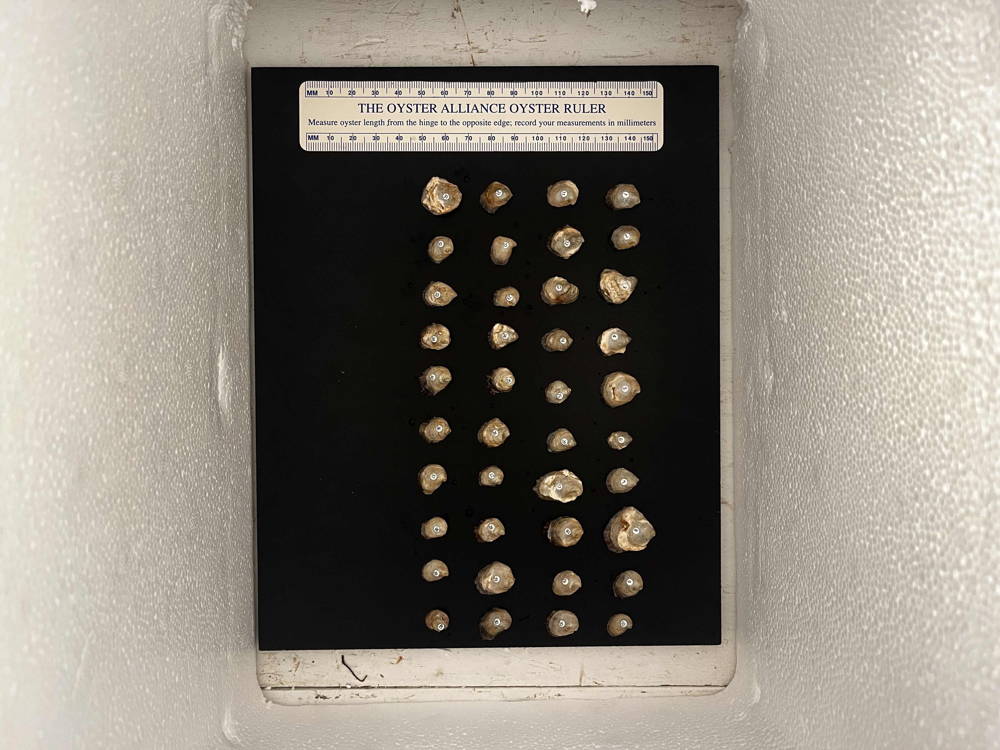

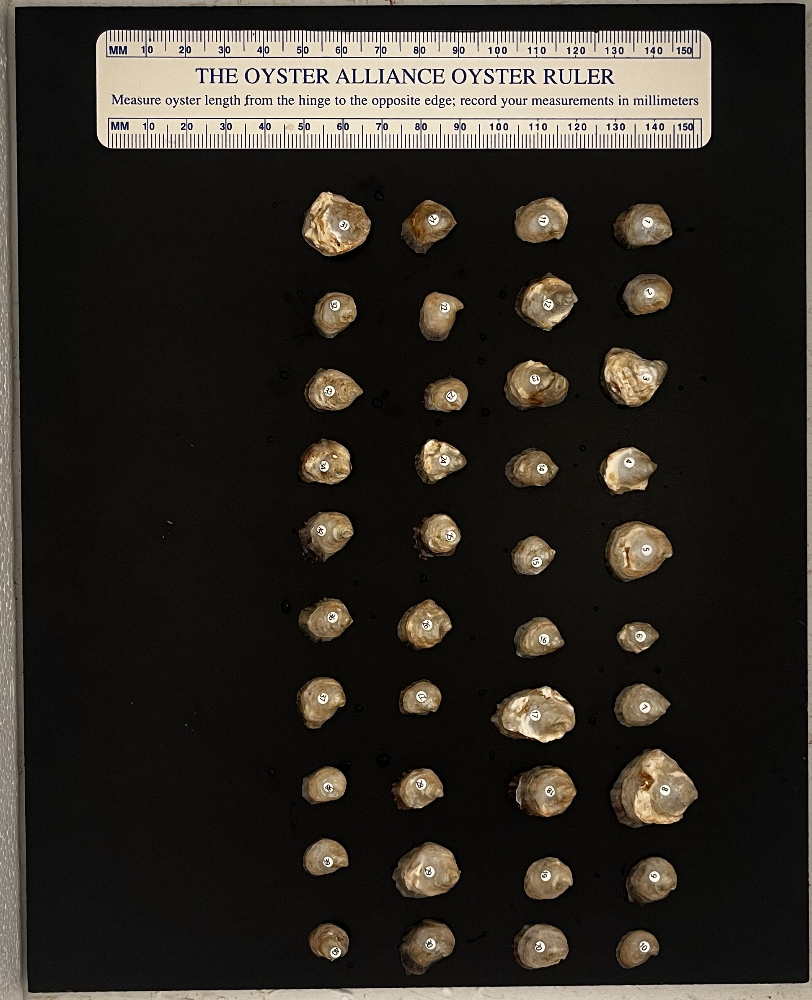

In [3]:
import cv2
import numpy as np
from PIL import Image
from IPython.display import display
import os
def diamond_kernel(radius):
    """Creates a diamond-shaped structuring element with given radius."""
    size = 2 * radius + 1
    kernel = np.zeros((size, size), dtype=np.uint8)
    for i in range(size):
        for j in range(size):
            if abs(i - radius) + abs(j - radius) <= radius:
                kernel[i, j] = 1
    return kernel
def imshow(im):
    display(Image.fromarray(cv2.cvtColor(im, cv2.COLOR_BGR2RGB)))
#
def cropstage(im):
    # 1. Convert to grayscale and apply Gaussian filtering.
    gray_im = cv2.cvtColor(im, cv2.COLOR_BGR2GRAY)
    gray_im = cv2.GaussianBlur(gray_im, (0, 0), sigmaX=3)

    # 2. Edge detection using Sobel operator.
    # Compute gradient magnitude.
    sobel_x = cv2.Sobel(gray_im, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_im, cv2.CV_64F, 0, 1, ksize=3)
    grad_mag = np.sqrt(sobel_x**2 + sobel_y**2)
    # Normalize to range 0-255 and convert to uint8.
    grad_mag = np.uint8(255 * grad_mag / grad_mag.max())

    # Use Otsu's threshold to convert gradient magnitude to binary edge image.
    _, edge_im = cv2.threshold(grad_mag, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    # 3. Morphological closing with a diamond-shaped kernel of radius 20.
    diamond = diamond_kernel(20)
    edge_im_closed = cv2.morphologyEx(edge_im, cv2.MORPH_CLOSE, diamond)
    # 4. Fill holes.
    # Approach: flood-fill from the border to find the background, invert it, then combine.
    im_floodfill = edge_im_closed.copy()
    h, w = im_floodfill.shape[:2]
    mask = np.zeros((h + 2, w + 2), np.uint8)
    cv2.floodFill(im_floodfill, mask, (0, 0), 255)
    # Invert floodfilled image to get the holes.
    im_floodfill_inv = cv2.bitwise_not(im_floodfill)
    # Combine to fill holes.
    big_obj = edge_im_closed | im_floodfill_inv
    #imshow(big_obj)
    # 5. Keep only the largest connected component.
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(big_obj, connectivity=8)
    if num_labels > 1:
        # Ignore background (label 0) and find the largest component.
        largest_label = 1 + np.argmax(stats[1:, cv2.CC_STAT_AREA])
        big_obj = np.zeros_like(big_obj)
        big_obj[labels == largest_label] = 255
    else:
        big_obj = np.zeros_like(big_obj)

    # 6. Morphological opening with a disk-shaped kernel (radius 50).
    disk_kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2 * 50 + 1, 2 * 50 + 1))
    big_obj = cv2.morphologyEx(big_obj, cv2.MORPH_OPEN, disk_kernel)

    # 7. Find the bounding box of the largest object.
    contours, _ = cv2.findContours(big_obj, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        # Select the largest contour by area.
        largest_contour = max(contours, key=cv2.contourArea)
        x, y, w_box, h_box = cv2.boundingRect(largest_contour)
        # Crop the stage area from the original image.
        stage = im[y:y+h_box, x:x+w_box]
    else:
        stage = im.copy()
    #display(Image.fromarray(cv2.cvtColor(stage, cv2.COLOR_BGR2RGB)))
    return stage

#Assume 'im' is your input RGB image loaded by OpenCV.
# Note: OpenCV loads images in BGR format.
# If needed, convert to RGB later for visualization.
imageDir = r"C:\Users\jems1\Documents\UMD\Lab\chelseaOyster\Black_typical"

for imDir in os.listdir(imageDir):
    if not imDir.endswith('.jpeg'):
        continue
    im = cv2.imread(os.path.join(imageDir,imDir))
    stage=cropstage(im)
    imshow(im)
    imshow(stage)
    break

